In [1]:
import pandas as pd
import json
import ast

file_path = 'datafreme_with_relations_and_nodes_cleaned.csv'  # Update this path to your file
df = pd.read_csv(file_path)

In [36]:
import pandas as pd
import re
import json

# Function to safely parse the properties as a string
def parse_properties(properties_string):
    try:
        # Remove the unmatched parentheses issue by trimming properly
        properties_string = properties_string.strip()
        if properties_string.startswith("{") and properties_string.endswith("}"):
            return json.loads(properties_string.replace("'", "\""))
        else:
            return {}
    except (ValueError, SyntaxError):
        return {}

# Function to extract nodes from custom string format
def extract_nodes(node_string):
    node_pattern = r"Node\(id=([A-Za-z0-9_]+),\s*type=([A-Za-z]+),\s*properties=\{(.*?)\}\)"
    nodes = re.findall(node_pattern, node_string)
    node_list = []
    for node in nodes:
        properties_string = f"{{{node[2]}}}"
        node_list.append({
            "id": node[0],
            "type": node[1],
            "properties": parse_properties(properties_string)
        })
    return node_list

# Function to extract relations from custom string format
def extract_relations(relation_string):
    relation_pattern = r"Relationship\(source=Node\(id=([A-Za-z0-9_]+),\s*type=([A-Za-z]+),\s*properties=\{(.*?)\}\),\s*target=Node\(id=([A-Za-z0-9_]+),\s*type=([A-Za-z]+),\s*properties=\{(.*?)\}\),\s*type=([A-Za-z_]+),\s*properties=\{(.*?)\}\)"
    relations = re.findall(relation_pattern, relation_string)
    relation_list = []
    for rel in relations:
        source_properties = f"{{{rel[2]}}}"
        target_properties = f"{{{rel[5]}}}"
        relation_properties = f"{{{rel[7]}}}"
        relation_list.append({
            "source": {
                "id": rel[0],
                "type": rel[1],
                "properties": parse_properties(source_properties)
            },
            "target": {
                "id": rel[3],
                "type": rel[4],
                "properties": parse_properties(target_properties)
            },
            "type": rel[6],
            "properties": parse_properties(relation_properties)
        })
    return relation_list

# Apply the extraction functions to the 'relations' and 'nodes' columns
df['parsed_nodes'] = df['nodes'].apply(extract_nodes)
df['parsed_relations'] = df['relations'].apply(extract_relations)

# Print the parsed results to verify
print("Parsed 'nodes' column (first 5 rows):")
print(df['parsed_nodes'].head())

print("\nParsed 'relations' column (first 5 rows):")
print(df['parsed_relations'].head())

# Prepare the final structure to hold the nodes and relations
json_output = {
    "nodes": [],
    "relations": []
}

# Collect unique nodes to avoid duplicates
unique_nodes = {}

# Extract nodes and relations from the dataframe
for index, row in df.iterrows():
    # Process nodes
    if row['parsed_nodes']:
        for node in row['parsed_nodes']:
            node_id = node['id']
            node_type = node['type']
            if node_id not in unique_nodes:
                unique_nodes[node_id] = {
                    "id": node_id,
                    "type": node_type,
                    "properties": node.get('properties', {})
                }
    
    # Process relations
    if row['parsed_relations']:
        for relation in row['parsed_relations']:
            json_output['relations'].append({
                "source": relation['source'],
                "target": relation['target'],
                "type": relation['type'],
                "properties": relation.get('properties', {})
            })

# Add all unique nodes to the final output
json_output['nodes'] = list(unique_nodes.values())

# Convert the output to a JSON string and save to file
output_file = 'nodes_and_relations_parsed.json'  # Replace with your desired output path
with open(output_file, 'w') as f:
    json.dump(json_output, f, indent=4)

# Print the JSON output to the console
print(json.dumps(json_output, indent=4))

print(f"JSON file created successfully: {output_file}")


Parsed 'nodes' column (first 5 rows):
0    [{'id': 'Project_Risk_Management', 'type': 'Pr...
1    [{'id': 'Project_Risk_Management', 'type': 'Pr...
2    [{'id': 'Project_Risk_Management', 'type': 'Pr...
3    [{'id': 'Project_Risk_Management', 'type': 'Pr...
4    [{'id': 'Recognize_The_Value_Of_Risk_Managemen...
Name: parsed_nodes, dtype: object

Parsed 'relations' column (first 5 rows):
0    [{'source': {'id': 'Project_Risk_Management', ...
1    [{'source': {'id': 'Project_Risk_Management', ...
2    [{'source': {'id': 'Project_Risk_Management', ...
3    [{'source': {'id': 'Project_Risk_Management', ...
4    [{'source': {'id': 'Recognize_The_Value_Of_Ris...
Name: parsed_relations, dtype: object
{
    "nodes": [
        {
            "id": "Project_Risk_Management",
            "type": "Process",
            "properties": {
                "category": "Project Management"
            }
        },
        {
            "id": "Pmbok_Guide_Fourth_Edition",
            "type": "Document",
  

In [37]:
# Convert the output to a JSON string and save to file
output_file = 'nodes_and_relations_parsed.json'  # Replace with your desired output path
with open(output_file, 'w') as f:
    json.dump(json_output, f, indent=4)

# Print the JSON output to the console
print(f"JSON file created successfully: {output_file}")


JSON file created successfully: nodes_and_relations_parsed.json


In [2]:
import json
import torch
from transformers import BertTokenizer, BertModel

# Load BERT model and tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

# Load the JSON file with nodes and relations
with open('nodes_and_relations_new.json', 'r') as f:
    data = json.load(f)

# Function to deduplicate and clean text lists
def deduplicate_and_clean(text_list):
    cleaned_list = list(set(text.rstrip(".").strip() for text in text_list))
    return cleaned_list

# Function to generate BERT embeddings for a given text
def get_bert_embedding(text):
    inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True)
    with torch.no_grad():
        outputs = model(**inputs)
    embeddings = outputs.last_hidden_state[:, 0, :].squeeze().cpu().numpy()
    return embeddings.tolist()

# Prepare a structure to store embeddings for nodes and relations
embeddings = {"nodes": {}, "relations": {}}

# Generate embeddings for nodes
for node in data['nodes']:
    node_text = f"{node['id']} {node['type']} {node['properties'].get('category', '')}"
    
    # Add description
    description = node['properties'].get('description', '')
    node_text += f" {description}"

    # Add deduplicated synonyms and keywords
    synonyms = deduplicate_and_clean(node['properties'].get('synonyms', []))
    keywords = deduplicate_and_clean(node['properties'].get('keywords', []))
    
    # Concatenate synonyms and keywords into the text
    node_text += " " + " ".join(synonyms + keywords)

    # Generate and store the embedding
    node_embedding = get_bert_embedding(node_text)
    embeddings["nodes"][node['id']] = node_embedding
    print(f"Node ID: {node['id']}, Embedding generated.")

# Generate embeddings for relations
for relation in data['relations']:
    relation_text = (
        f"{relation['source']['id']} {relation['source']['type']} {relation['source']['properties'].get('category', '')}"
    )
    
    # Add source description, synonyms, and keywords
    source_description = relation['source']['properties'].get('description', '')
    relation_text += f" {source_description}"

    source_synonyms = deduplicate_and_clean(relation['source']['properties'].get('synonyms', []))
    source_keywords = deduplicate_and_clean(relation['source']['properties'].get('keywords', []))
    relation_text += " " + " ".join(source_synonyms + source_keywords)
    
    # Add relation type
    relation_text += f" {relation['type']} {relation['target']['id']} {relation['target']['type']} {relation['target']['properties'].get('category', '')}"

    # Add target description, synonyms, and keywords
    target_description = relation['target']['properties'].get('description', '')
    relation_text += f" {target_description}"

    target_synonyms = deduplicate_and_clean(relation['target']['properties'].get('synonyms', []))
    target_keywords = deduplicate_and_clean(relation['target']['properties'].get('keywords', []))
    relation_text += " " + " ".join(target_synonyms + target_keywords)

    # Generate and store the embedding
    relation_embedding = get_bert_embedding(relation_text)
    relation_key = f"{relation['source']['id']}_{relation['target']['id']}"
    embeddings["relations"][relation_key] = relation_embedding
    print(f"Relation: {relation['source']['id']} -> {relation['target']['id']}, Embedding generated.")

# Save the embeddings to a new JSON file
with open('bert_embeddings_with_metadata.json', 'w') as f:
    json.dump(embeddings, f)

print("Embeddings with metadata generated and saved to 'bert_embeddings_with_metadata.json'")


c:\Users\arafe\anaconda3\envs\venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Node ID: Project_Risk_Management, Embedding generated.
Node ID: Pmbok_Guide_Fourth_Edition, Embedding generated.
Node ID: Project_Management_Institute, Embedding generated.
Node ID: Project_Risk_Management_Processes, Embedding generated.
Node ID: Plan_Risk_Management, Embedding generated.
Node ID: Identify_Risks, Embedding generated.
Node ID: Perform_Qualitative_Risk_Analysis, Embedding generated.
Node ID: Perform_Quantitative_Risk_Analysis, Embedding generated.
Node ID: Plan_Risk_Responses, Embedding generated.
Node ID: Monitor_And_Control_Risks, Embedding generated.
Node ID: Project_Managers, Embedding generated.
Node ID: Project_Risk, Embedding generated.
Node ID: Project_Objectives, Embedding generated.
Node ID: Scope, Embedding generated.
Node ID: Schedule, Embedding generated.
Node ID: Cost, Embedding generated.
Node ID: Quality, Embedding generated.
Node ID: Project_Management, Embedding generated.
Node ID: Project_Plans, Embedding generated.
Node ID: Project_Management_Processe

In [2]:
import json
import torch
from transformers import BertTokenizer, BertModel

# Load BERT model and tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

# Load the JSON file with nodes and relations
with open('nodes_and_relations_new.json', 'r') as f:
    data = json.load(f)

# Function to generate BERT embeddings for a given text
def get_bert_embedding(text):
    inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True)
    with torch.no_grad():
        outputs = model(**inputs)
    # Take the embeddings from the [CLS] token and convert to a list
    embeddings = outputs.last_hidden_state[:, 0, :].squeeze().cpu().numpy()
    return embeddings.tolist()

# Prepare a structure to store embeddings for nodes and relations
embeddings = {"nodes": {}, "relations": {}}

# Generate embeddings for nodes (id + type + description)
for node in data['nodes']:
    node_text = f"{node['id']} {node['type']}"
    
    # Add description if it exists in properties
    if 'description' in node['properties']:
        description = node['properties']['description']
        node_text += f" {description}"

    node_embedding = get_bert_embedding(node_text)
    embeddings["nodes"][node['id']] = node_embedding
    print(f"Node ID: {node['id']}, Embedding: {node_embedding}")  # Print node embeddings

# Generate embeddings for relations (source + type + description + target)
for relation in data['relations']:
    relation_text = f"{relation['source']['id']} {relation['source']['type']}"
    
    # Add description for source if it exists
    if 'description' in relation['source']['properties']:
        source_description = relation['source']['properties']['description']
        relation_text += f" {source_description}"
    
    relation_text += f" {relation['type']} {relation['target']['id']} {relation['target']['type']}"
    
    # Add description for target if it exists
    if 'description' in relation['target']['properties']:
        target_description = relation['target']['properties']['description']
        relation_text += f" {target_description}"

    relation_embedding = get_bert_embedding(relation_text)
    embeddings["relations"][f"{relation['source']['id']}_{relation['target']['id']}"] = relation_embedding
    print(f"Relation: {relation['source']['id']} -> {relation['target']['id']}, Embedding: {relation_embedding}")  # Print relation embeddings

# Save the embeddings to a new JSON file
with open('bert_embeddings_with_description.json', 'w') as f:
    json.dump(embeddings, f)

print("Embeddings with descriptions generated and saved to 'bert_embeddings_with_description.json'")


c:\Users\arafe\anaconda3\envs\venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\arafe\anaconda3\envs\venv\Lib\site-packages\huggingface_hub\file_download.py:139: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\arafe\.cache\huggingface\hub\models--bert-base-uncased. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer m

Node ID: Project_Risk_Management, Embedding: [-0.2389305979013443, 0.3341546058654785, -0.48869094252586365, -0.013702219352126122, -0.21511593461036682, -0.23387274146080017, 0.3360007107257843, 0.5588616728782654, 0.16406090557575226, -0.46310222148895264, -0.24667572975158691, -0.05913638323545456, -0.3580447733402252, 0.5146587491035461, -0.06576640903949738, 0.8227387070655823, -0.026072070002555847, 0.5402281880378723, 0.05232832580804825, 0.015620609745383263, -0.5883116126060486, -1.2783757448196411, 0.009209002368152142, 0.14496564865112305, -0.022906623780727386, 0.06532029062509537, -0.4672945439815521, 0.06826947629451752, 0.35588228702545166, -0.14365488290786743, 0.12727132439613342, 0.22522272169589996, -0.5449675917625427, -0.4959688186645508, 0.7013864517211914, 0.13710513710975647, -0.0798225998878479, -0.055569473654031754, -0.13592751324176788, 0.17072424292564392, -0.5059763789176941, 0.28897276520729065, 0.17993620038032532, -0.5091704726219177, -0.272986471652984

In [2]:
import json

# Load the JSON file with embeddings
with open('bert_embeddings_with_metadata.json', 'r') as f:
    embeddings = json.load(f)

C:\Users\arafe\AppData\Local\Temp\ipykernel_16160\4047767208.py:15: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], cmap='viridis')


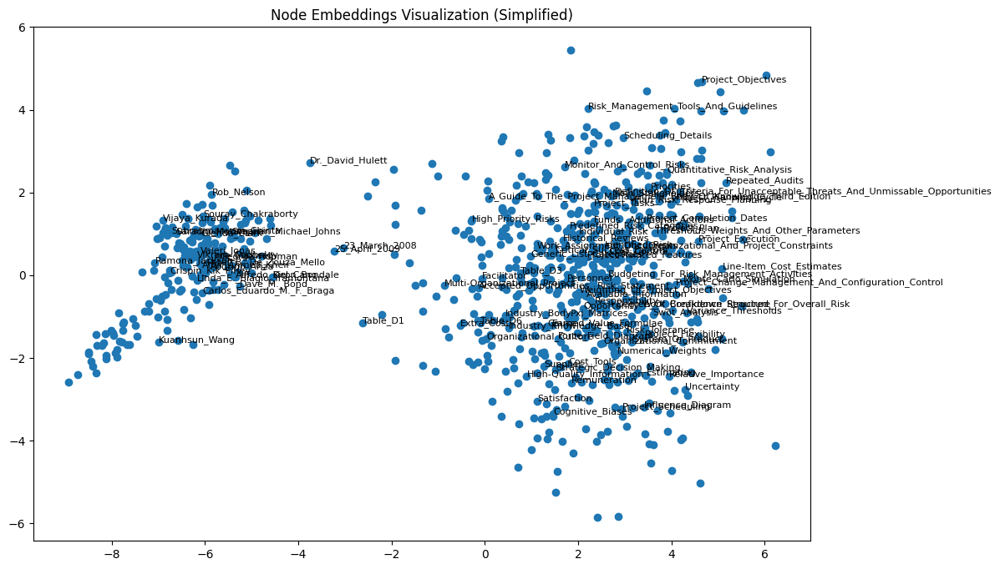

In [3]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import random

# Extract node embeddings and labels
node_embeddings = list(embeddings['nodes'].values())
node_labels = list(embeddings['nodes'].keys())

# Apply PCA for dimensionality reduction (2D)
pca = PCA(n_components=2)
reduced_embeddings = pca.fit_transform(node_embeddings)

# Plot the reduced embeddings
plt.figure(figsize=(12, 8))
plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], cmap='viridis')

# Randomly choose a subset of points to annotate to reduce clutter
subset_size = 100  # Define how many labels to show
indices = random.sample(range(len(node_labels)), subset_size)

# Annotate only the selected points
for i in indices:
    plt.annotate(node_labels[i], (reduced_embeddings[i, 0], reduced_embeddings[i, 1]), fontsize=8)

plt.title('Node Embeddings Visualization (Simplified)')
plt.show()

In [5]:
from sklearn.metrics.pairwise import cosine_similarity

# Calculate similarity matrix
similarity_matrix = cosine_similarity(node_embeddings)
print("Cosine Similarity Matrix:\n", similarity_matrix)

Cosine Similarity Matrix:
 [[1.         0.87128079 0.85541871 ... 0.8414956  0.83114738 0.79782169]
 [0.87128079 1.         0.90039206 ... 0.85360454 0.86471816 0.79861545]
 [0.85541871 0.90039206 1.         ... 0.86287136 0.83808586 0.7902928 ]
 ...
 [0.8414956  0.85360454 0.86287136 ... 1.         0.90290991 0.82823091]
 [0.83114738 0.86471816 0.83808586 ... 0.90290991 1.         0.88219792]
 [0.79782169 0.79861545 0.7902928  ... 0.82823091 0.88219792 1.        ]]
